In [ ]:
!pip install torch==1.7.1+cu101 torchvision==0.8.2+cu101 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
!pip install fvcore
!pip install pillow==7.2.0
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 735.4MB 13kB/s 
     |████████████████████████████████| 12.8MB 248kB/s 
     |████████████████████████████████| 7.6MB 7.9MB/s 
  Found existing installation: torch 1.7.0+cu101
    Uninstalling torch-1.7.0+cu101:
      Successfully uninstalled torch-1.7.0+cu101
  Found existing installation: torchvision 0.8.1+cu101
    Uninstalling torchvision-0.8.1+cu101:
      Successfully uninstalled torchvision-0.8.1+cu101
Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.7.1+cu101)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.8.2+cu101)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-s577hzsj
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-s577hzsj
     |████████████████████████████████| 276kB 10.0MB/s 
  Created wheel for fvcore: filena

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-ruc6jpl3
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-ruc6jpl3
  Created wheel for detectron2: filename=detectron2-0.3-cp36-cp36m-linux_x86_64.whl size=5543658 sha256=7ec087e1a7dd73d2b9e4cfbe6c768cbc05387f2447e006df92dd3ef2c3eb187a
  Stored in directory: /tmp/pip-ephem-wheel-cache-0ffvj18k/wheels/33/ac/bb/5ef90585c21c67e2f0b6aae55ec6b43017ad57af33d5f4c339
Successfully built detectron2


'1.7.1+cu101'

In [ ]:
import os
import json
import math

from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets.coco import convert_to_coco_json

def get_rotated_teeth_dicts(json_dir):
    json_file = json_dir
    with open(json_file) as f:
        imgs_anns = json.load(f)
    check = []
    for z in range(len(imgs_anns['images'])):
      record = {}
      record['file_name'] = imgs_anns['images'][z]['file_name']
      record['image_id'] = imgs_anns['images'][z]['id']
      record['width'] = imgs_anns['images'][z]['width']
      record['height'] = imgs_anns['images'][z]['height']
      anno_list = []
      for i in range(len(imgs_anns['annotations'])):
        anno = {}
        if imgs_anns['images'][z]['id'] == imgs_anns['annotations'][i]['image_id']:
          anno['bbox'] = imgs_anns['annotations'][i]['bbox']
          anno['bbox'][-1] = -math.degrees(anno['bbox'][-1])
          anno['bbox_mode'] = BoxMode.XYWHA_ABS
          anno['segmentation'] = []
          anno['category_id'] = imgs_anns['annotations'][i]['category_id']
          anno_list.append(anno)
      record['annotations'] = anno_list
      check.append(record)

    return check

In [ ]:
from detectron2.modeling import box_regression
class Box2BoxTransformRotated(object):

  def get_deltas(self, src_boxes, target_boxes):
          """
          Get box regression transformation deltas (dx, dy, dw, dh, da) that can be used
          to transform the `src_boxes` into the `target_boxes`. That is, the relation
          ``target_boxes == self.apply_deltas(deltas, src_boxes)`` is true (unless
          any delta is too large and is clamped).
          Args:
              src_boxes (Tensor): Nx5 source boxes, e.g., object proposals
              target_boxes (Tensor): Nx5 target of the transformation, e.g., ground-truth
                  boxes.
          """
          assert isinstance(src_boxes, torch.Tensor), type(src_boxes)
          assert isinstance(target_boxes, torch.Tensor), type(target_boxes)

          src_ctr_x, src_ctr_y, src_widths, src_heights, src_angles = torch.unbind(src_boxes, dim=1)

          target_ctr_x, target_ctr_y, target_widths, target_heights, target_angles = torch.unbind(
              target_boxes, dim=1
          )

          wx, wy, ww, wh, wa = self.weights
          dx = wx * (np.cos(src_angles) * (target_ctr_x - src_ctr_x) + np.sin(src_angles) * (target_ctr_y - src_ctr_y)) / src_widths
          dy = wy * (-np.sin(src_angles) * (target_ctr_x - src_ctr_x) + np.cos(src_angles) * (target_ctr_y - src_ctr_y)) / src_heights
          dw = ww * torch.log(target_widths / src_widths)
          dh = wh * torch.log(target_heights / src_heights)
          # Angles of deltas are in radians while angles of boxes are in degrees.
          # the conversion to radians serve as a way to normalize the values
          da = (target_angles - src_angles) / 90
          da = (da + 180.0) % 360.0 - 180.0  # make it in [-180, 180)
          da *= wa * math.pi / 180.0

          deltas = torch.stack((dx, dy, dw, dh, da), dim=1)
          assert (
              (src_widths > 0).all().item()
          ), "Input boxes to Box2BoxTransformRotated are not valid!"
          return deltas
      

  def apply_deltas(self, deltas, boxes):
    

        """
        Apply transformation `deltas` (dx, dy, dw, dh, da) to `boxes`.
        Args:
            deltas (Tensor): transformation deltas of shape (N, k*5).
                deltas[i] represents box transformation for the single box boxes[i].
            boxes (Tensor): boxes to transform, of shape (N, 5)
        """
        assert deltas.shape[1] % 5 == 0 and boxes.shape[1] == 5

        boxes = boxes.to(deltas.dtype).unsqueeze(2)

        ctr_x = boxes[:, 0] #px
        ctr_y = boxes[:, 1] #py
        widths = boxes[:, 2] #pw
        heights = boxes[:, 3] #ph
        angles = boxes[:, 4] #pa, alpha

        wx, wy, ww, wh, wa = self.weights

        dx = deltas[:, 0::5] / wx #tx
        dy = deltas[:, 1::5] / wy #ty 
        dw = deltas[:, 2::5] / ww #tw
        dh = deltas[:, 3::5] / wh #th
        da = deltas[:, 4::5] / wa #ta

        # Prevent sending too large values into torch.exp()
        dw = torch.clamp(dw, max=self.scale_clamp)
        dh = torch.clamp(dh, max=self.scale_clamp)

        pred_boxes = torch.zeros_like(deltas)
        pred_boxes[:, 0::5] = dx * widths *np.cos(angles) - dy * heights * np.sin(angles) + ctr_x  # x_ctr
        pred_boxes[:, 1::5] = dx * widths *np.sin(angles) - dy * heights * np.cos(angles) + ctr_y  # y_ctr
        pred_boxes[:, 2::5] = torch.exp(dw) * widths  # width
        pred_boxes[:, 3::5] = torch.exp(dh) * heights  # height

        # Following original RRPN implementation,
        # angles of deltas are in radians while angles of boxes are in degrees.
        pred_angle = da * 180.0 * 0.5 + angles
        pred_angle = (pred_angle + 180.0) % 360.0 - 180.0  # make it in [-180, 180)
        pred_boxes[:, 4::5] = pred_angle    

        return pred_boxes

In [ ]:
#import datetime
from fvcore.common.file_io import PathManager
from detectron2.engine import DefaultPredictor
from detectron2.data.datasets.coco import convert_to_coco_json
from detectron2.structures import Boxes, BoxMode

def convert_to_coco_dict(dataset_name):

    dataset_dicts = DatasetCatalog.get(dataset_name)
    metadata = MetadataCatalog.get(dataset_name)

    # unmap the category mapping ids for COCO
    if hasattr(metadata, "thing_dataset_id_to_contiguous_id"):
        reverse_id_mapping = {v: k for k, v in metadata.thing_dataset_id_to_contiguous_id.items()}
        reverse_id_mapper = lambda contiguous_id: reverse_id_mapping[contiguous_id]  # noqa
    else:
        reverse_id_mapper = lambda contiguous_id: contiguous_id  # noqa

    categories = [
        {"id": reverse_id_mapper(id), "name": name}
        for id, name in enumerate(metadata.thing_classes)
    ]

    coco_images = []
    coco_annotations = []

    for image_id, image_dict in enumerate(dataset_dicts):
        #print(str(image_id) + str(image_dict))
        coco_image = {
            "id": image_dict.get("image_id", image_id),
            "width": image_dict["width"],
            "height": image_dict["height"],
            "file_name": image_dict["file_name"],
        }
        coco_images.append(coco_image)

        anns_per_image = image_dict["annotations"]
        for annotation in anns_per_image:
            # create a new dict with only COCO fields
            coco_annotation = {}

            # COCO requirement: XYWH box format
            bbox = annotation["bbox"]
            bbox_mode = annotation["bbox_mode"]
            # Computing areas using bounding boxes
            bbox_xy = BoxMode.convert(bbox, bbox_mode, BoxMode.XYXY_ABS)
            area = Boxes([bbox_xy]).area()[0].item()

            if "keypoints" in annotation:
                keypoints = annotation["keypoints"]  # list[int]
                for idx, v in enumerate(keypoints):
                    if idx % 3 != 2:
                        # COCO's segmentation coordinates are floating points in [0, H or W],
                        # but keypoint coordinates are integers in [0, H-1 or W-1]
                        # For COCO format consistency we substract 0.5
                        # https://github.com/facebookresearch/detectron2/pull/175#issuecomment-551202163
                        keypoints[idx] = v - 0.5
                if "num_keypoints" in annotation:
                    num_keypoints = annotation["num_keypoints"]
                else:
                    num_keypoints = sum(kp > 0 for kp in keypoints[2::3])

            # COCO requirement:
            #   linking annotations to images
            #   "id" field must start with 1
            coco_annotation["id"] = len(coco_annotations) + 1
            coco_annotation["image_id"] = coco_image["id"]
            coco_annotation["bbox"] = [round(float(x), 3) for x in bbox]
            coco_annotation["area"] = float(area)
            coco_annotation["iscrowd"] = annotation.get("iscrowd", 0)
            coco_annotation["category_id"] = reverse_id_mapper(annotation["category_id"])

            # Add optional fields
            coco_annotations.append(coco_annotation)


    info = {
        "date_created": str(datetime.datetime.now()),
        "description": "Automatically generated COCO json file for Detectron2.",
    }
    coco_dict = {
        "info": info,
        "images": coco_images,
        "annotations": coco_annotations,
        "categories": categories,
        "licenses": None,
    }
    return coco_dict


def convert_to_coco_json(dataset_name, output_file, allow_cached=True):

    coco_dict = convert_to_coco_dict(dataset_name)

    PathManager.mkdirs(os.path.dirname(output_file))
    with PathManager.open(output_file, "w") as f:
      json.dump(coco_dict, f)

class RotatedPredictor(DefaultPredictor):
    def __init__(self, cfg):
        
        self.cfg = cfg.clone()  # cfg can be modified by model
        self.model = trainer.model
        self.model.eval()

        self.transform_gen = T.ResizeShortestEdge(
            [cfg.INPUT.MIN_SIZE_TEST, cfg.INPUT.MIN_SIZE_TEST], cfg.INPUT.MAX_SIZE_TEST
        )

        self.input_format = cfg.INPUT.FORMAT
        assert self.input_format in ["RGB", "BGR"], self.input_format

    def __call__(self, original_image):
        """
        Args:
            original_image (np.ndarray): an image of shape (H, W, C) (in BGR order).
        Returns:
            predictions (dict):
                the output of the model for one image only.
                See :doc:`/tutorials/models` for details about the format.
        """
        with torch.no_grad():  # https://github.com/sphinx-doc/sphinx/issues/4258
            # Apply pre-processing to image.
            if self.input_format == "RGB":
                # whether the model expects BGR inputs or RGB
                original_image = original_image[:, :, ::-1]
            height, width = original_image.shape[:2]
            image = self.transform_gen.get_transform(original_image).apply_image(original_image)
            image = torch.as_tensor(image.astype("float32").transpose(2, 0, 1))

            inputs = {"image": image, "height": height, "width": width}
            predictions = self.model([inputs])[0]
            return predictions

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [ ]:
from detectron2.data import build_detection_train_loader
from detectron2.data import detection_utils as utils
from detectron2.data import transforms as T
from detectron2.evaluation import RotatedCOCOEvaluator
from detectron2.engine import DefaultTrainer

import copy,torch,torchvision

def my_transform_instance_annotations(annotation, transforms, image_size, *, keypoint_hflip_indices=None):
  
  if annotation["bbox_mode"] == BoxMode.XYWHA_ABS:
    annotation["bbox"] = transforms.apply_rotated_box(np.asarray([annotation["bbox"]]))[0]
  else:
    bbox = BoxMode.convert(annotation["bbox"], annotation["bbox_mode"], BoxMode.XYXY_ABS)
    # Note that bbox is 1d (per-instance bounding box)
    annotation["bbox"] = transforms.apply_box([bbox])[0]
    annotation["bbox_mode"] = BoxMode.XYXY_ABS

  return annotation

def mapper(dataset_dict):
  # Implement a mapper, similar to the default DatasetMapper, but with your own customizations
  dataset_dict = copy.deepcopy(dataset_dict)  # it will be modified by code below
  image = utils.read_image(dataset_dict["file_name"], format="BGR")
  image, transforms = T.apply_transform_gens([T.Resize((800, 800))], image)
  dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))

  annos = [
      my_transform_instance_annotations(obj, transforms, image.shape[:2])  ############################################
      for obj in dataset_dict.pop("annotations")
      if obj.get("iscrowd", 0) == 0
  ]
  instances = utils.annotations_to_instances_rotated(annos, image.shape[:2])
  dataset_dict["instances"] = utils.filter_empty_instances(instances)
  return dataset_dict

class MyTrainer(DefaultTrainer):
  @classmethod
  def build_evaluator(cls, cfg, dataset_name):
      output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
      evaluators = [RotatedCOCOEvaluator(dataset_name, cfg, True, output_folder)]
      return DatasetEvaluators(evaluators)
  @classmethod
  def build_train_loader(cls, cfg):
      return build_detection_train_loader(cfg,mapper=mapper)

In [ ]:
import cv2
import random
from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import Visualizer


class myVisualizer(Visualizer):
  
    def draw_dataset_dict(self, dic):
        annos = dic.get("annotations", None)
        if annos:
            if "segmentation" in annos[0]:
                masks = [x["segmentation"] for x in annos]
            else:
                masks = None
            if "keypoints" in annos[0]:
                keypts = [x["keypoints"] for x in annos]
                keypts = np.array(keypts).reshape(len(annos), -1, 3)
            else:
                keypts = None
            # for x in annos:
            #   x["bbox"][-1] = 180. - math.degrees(x["bbox"][-1])
            boxes = [BoxMode.convert(x["bbox"], x["bbox_mode"], BoxMode.XYWHA_ABS) for x in annos]



            labels = [x["category_id"] for x in annos]
            names = self.metadata.get("thing_classes", None)
            if names:
                labels = [names[i] for i in labels]
            labels = [
                "{}".format(i) + ("|crowd" if a.get("iscrowd", 0) else "")
                for i, a in zip(labels, annos)
            ]
            self.overlay_instances(labels=labels, boxes=boxes, masks=masks, keypoints=keypts)

        sem_seg = dic.get("sem_seg", None)
        if sem_seg is None and "sem_seg_file_name" in dic:
            sem_seg = cv2.imread(dic["sem_seg_file_name"], cv2.IMREAD_GRAYSCALE)
        if sem_seg is not None:
            self.draw_sem_seg(sem_seg, area_threshold=0, alpha=0.5)
        return self.output

    def draw_instance_predictions(self, predictions):
        """
        Draw instance-level prediction results on an image.
        Args:
            predictions (Instances): the output of an instance detection/segmentation
                model. Following fields will be used to draw:
                "pred_boxes", "pred_classes", "scores", "pred_masks" (or "pred_masks_rle").
        Returns:
            output (VisImage): image object with visualizations.
        """
        boxes = predictions.pred_boxes if predictions.has("pred_boxes") else None
        scores = predictions.scores if predictions.has("scores") else None
        classes = predictions.pred_classes if predictions.has("pred_classes") else None
        labels = _create_text_labels(classes, scores, self.metadata.get("thing_classes", None))
        keypoints = predictions.pred_keypoints if predictions.has("pred_keypoints") else None

        if predictions.has("pred_masks"):
            masks = np.asarray(predictions.pred_masks)
            masks = [GenericMask(x, self.output.height, self.output.width) for x in masks]
        else:
            masks = None

        if self._instance_mode == ColorMode.SEGMENTATION and self.metadata.get("thing_colors"):
            colors = [
                self._jitter([x / 255 for x in self.metadata.thing_colors[c]]) for c in classes
            ]
            alpha = 0.8
        else:
            colors = None
            alpha = 0.5

        if self._instance_mode == ColorMode.IMAGE_BW:
            assert predictions.has("pred_masks"), "ColorMode.IMAGE_BW requires segmentations"
            self.output.img = self._create_grayscale_image(
                (predictions.pred_masks.any(dim=0) > 0).numpy()
            )
            alpha = 0.3

        self.overlay_instances(
            masks=masks,
            boxes=boxes,
            labels=labels,
            keypoints=keypoints,
            assigned_colors=colors,
            alpha=alpha,
        )
        return self.output

In [ ]:
cd ./data/rotated_dataset

/content/drive/My Drive/rotated_dataset


In [ ]:
import datetime
for d in ["train","test"]:
    DatasetCatalog.register("rotated_teeth_"+d, lambda d=d: get_rotated_teeth_dicts("/content/drive/My Drive/rotated_dataset/rb" + d + ".json"))
    MetadataCatalog.get("rotated_teeth_"+d).set(thing_classes=["Upper molar", "Upper premolar", "Upper Canine",
                                                                      "Upper Lateral incisor", "Upper Central incisor",
                                                                      "Lower molar", "Lower premolar", "Lower Canine",
                                                                      "Lower Lateral incisor", "Lower Central incisor",'Implant'])
    convert_to_coco_json("rotated_teeth_"+d, ''.join("./output/"+"rotated_teeth_"+d+"_coco_format.json"))
rename_rotated_teeth_train = MetadataCatalog.get("rotated_teeth_train")
rename_rotated_teeth_test = MetadataCatalog.get("rotated_teeth_test")

Rotated_Train_img


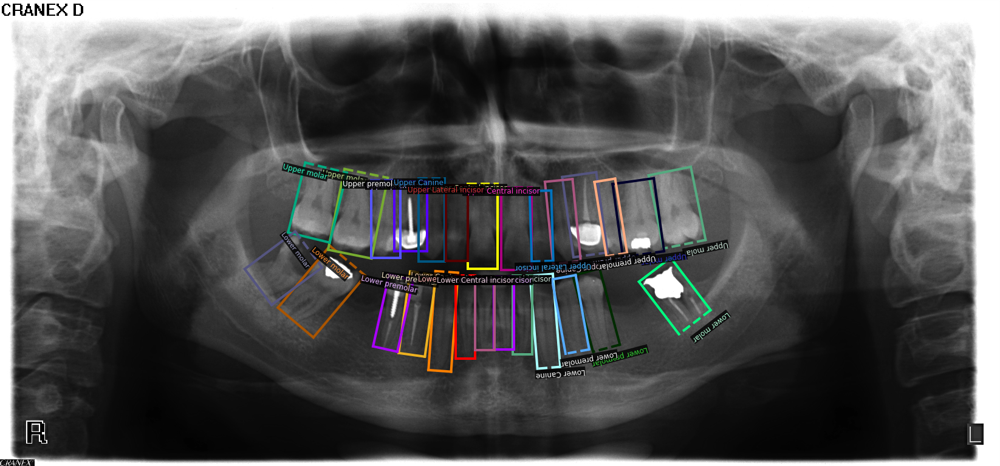

Rotated_Train_img


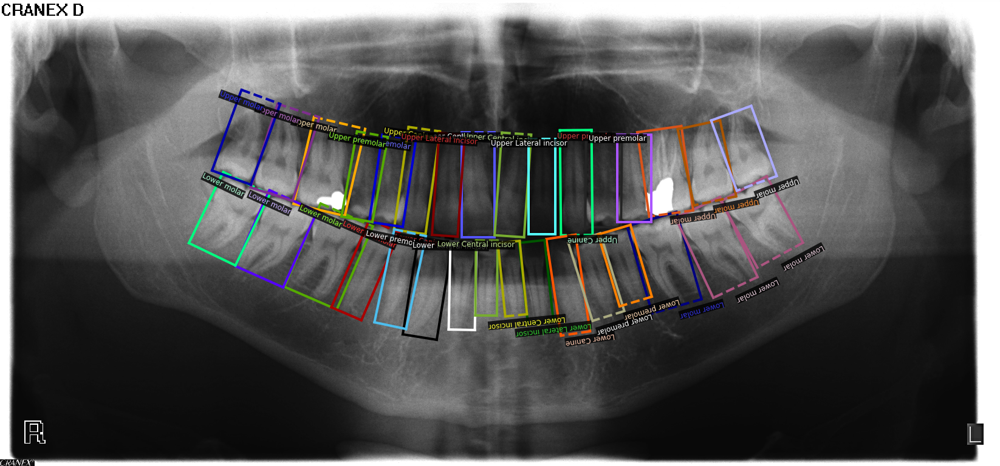

Rotated_Train_img


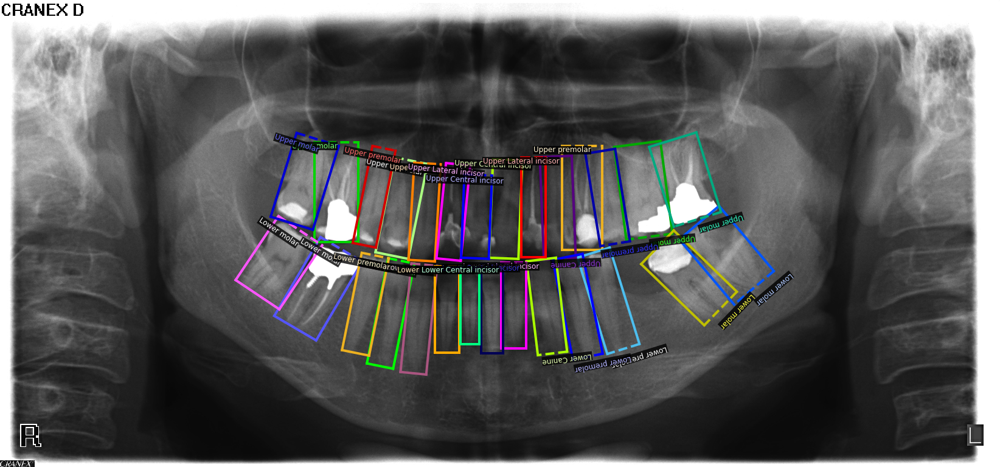

Rotated_Test_img


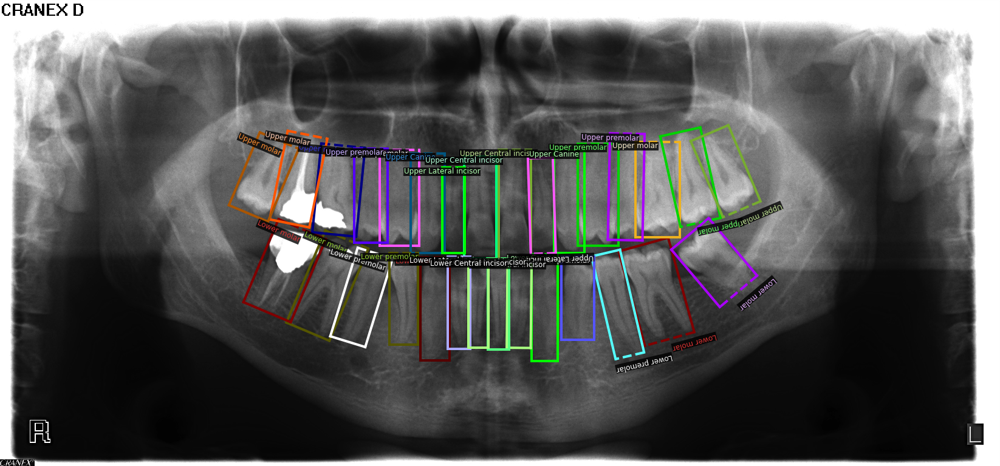

Rotated_Test_img


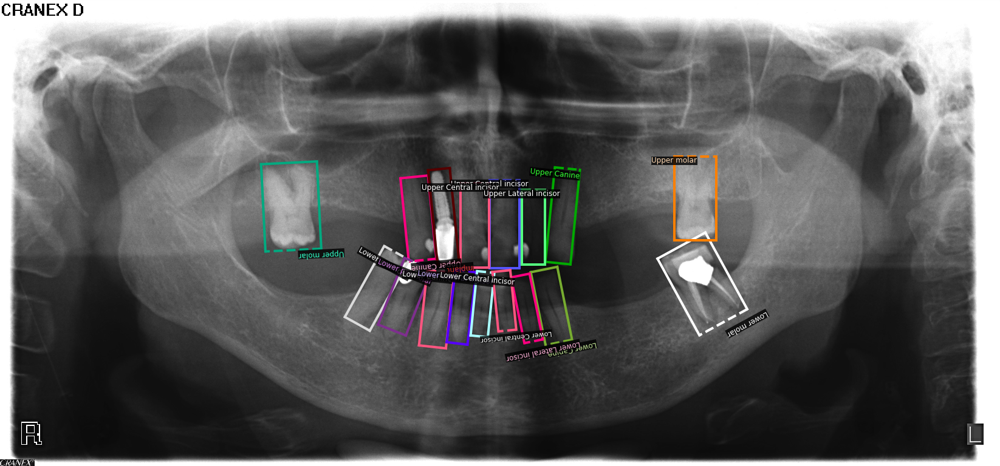

Rotated_Test_img


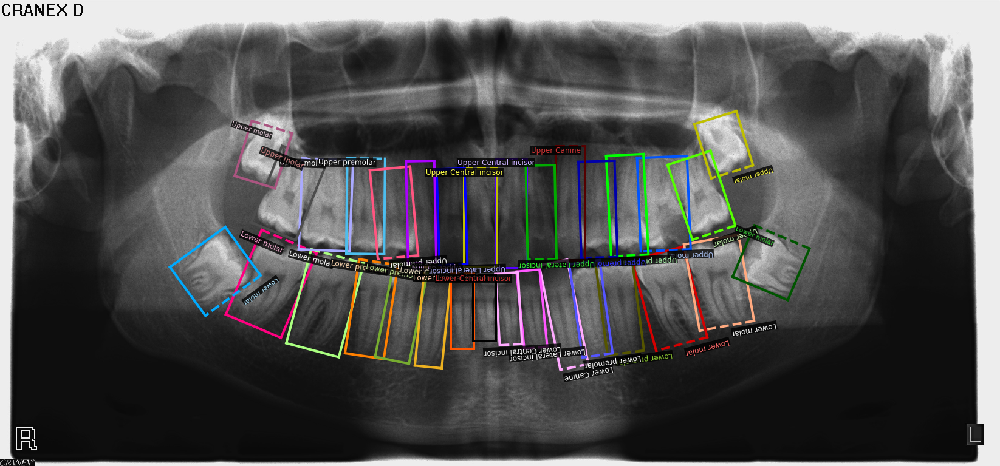

In [ ]:
import json,random,cv2
import numpy as np

from google.colab.patches import cv2_imshow
from detectron2.utils.visualizer import Visualizer

dataset_dicts = get_rotated_teeth_dicts("/content/drive/My Drive/rotated_dataset/rbtrain.json")
for d in random.sample(dataset_dicts, 3):
    print("Rotated_Train_img")
    img = cv2.imread("/content/drive/My Drive/rotated_dataset/" + d["file_name"])
    visualizer = myVisualizer(img[:, :, ::-1], metadata=rename_rotated_teeth_train, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

dataset_dicts = get_rotated_teeth_dicts("/content/drive/My Drive/rotated_dataset/rbtest.json")
for d in random.sample(dataset_dicts, 3):
    print("Rotated_Test_img")
    img = cv2.imread("/content/drive/My Drive/rotated_dataset/" + d["file_name"])
    visualizer = myVisualizer(img[:, :, ::-1], metadata=rename_rotated_teeth_train, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
model = ["COCO-Detection/faster_rcnn_R_50_FPN_1x.yaml",
         "COCO-Detection/faster_rcnn_R_50_C4_3x.yaml",
         "COCO-Detection/faster_rcnn_R_50_DC5_3x.yaml",
         "COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml",
         "COCO-Detection/faster_rcnn_R_101_C4_3x.yaml",
         "COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml",
         "COCO-Detection/retinanet_R_101_FPN_3x.yaml"]
input_model = model[5]

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

cfg = get_cfg()

cfg.CUDNN_BENCHMARK = False
cfg.SEED = 1

cfg.merge_from_file(model_zoo.get_config_file(input_model))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(input_model) 

cfg.MODEL.PROPOSAL_GENERATOR.NAME = "RRPN" #using RRPN
cfg.MODEL.RPN.HEAD_NAME = "StandardRPNHead" # RRPN inherit RPN class
cfg.MODEL.RPN.BBOX_REG_WEIGHTS = (1,1,1,1,1) # weights for coordinate
cfg.MODEL.RPN.BBOX_REG_LOSS_TYPE = "smooth_l1"
cfg.MODEL.RPN.BBOX_REG_LOSS_WEIGHT = 1.0

cfg.MODEL.ANCHOR_GENERATOR.NAME = "RotatedAnchorGenerator"
# cfg.MODEL.ANCHOR_GENERATOR.ANGLES = [[0, 25, 125, 150, 175]]
cfg.MODEL.ANCHOR_GENERATOR.ANGLES = [[0, -25, -75, -125, -150, -175]]


cfg.DATASETS.TRAIN = ("rotated_teeth_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00250  # pick a good LR
cfg.SOLVER.MAX_ITER = 2000   # 300 iterations seems good enough for this toy dataset; you may need to train longer for a practical dataset


cfg.MODEL.ROI_HEADS.NAME = "RROIHeads"
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 17

cfg.MODEL.ROI_BOX_HEAD.BBOX_REG_LOSS_TYPE = "smooth_l1"
cfg.MODEL.ROI_BOX_HEAD.BBOX_REG_LOSS_WEIGHT = 1.0
cfg.MODEL.ROI_BOX_HEAD.NORM = "SyncBN"
cfg.MODEL.ROI_BOX_HEAD.SMOOTH_L1_BETA = 0.0

cfg.MODEL.ROI_BOX_HEAD.POOLER_TYPE = "ROIAlignRotated"
cfg.MODEL.ROI_BOX_HEAD.BBOX_REG_WEIGHTS = (10,10,15,15,10) # weights for coordinate

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = MyTrainer(cfg)
trainer.resume_or_load(resume=False)

[12/30 13:22:27 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:06, 64.1MB/s]                           
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.0' to the model due to incompatible shapes: (3, 4) in the checkpoint but (18, 5) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.1' to the model due to incompatible shapes: (3, 4) in the checkpoint but (18, 5) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.2' to the model due to incompatible shapes: (3, 4) in the checkpoint but (18, 5) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.anchor_generator.cell_anchors.3' to the model due to incompatible shapes: (3, 4) in the checkpoint but (18, 5) in the model! You might want to double check if this is expected.
Skip loading parameter 'proposal_generator.an

In [ ]:
trainer.train()

[12/30 13:22:34 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:225: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  num_fg = fg_inds.nonzero().numel()


[12/30 13:22:58 d2.utils.events]:  eta: 0:36:51  iter: 19  total_loss: 3.981  loss_cls: 2.544  loss_box_reg: 0.008819  loss_rpn_cls: 0.7009  loss_rpn_loc: 0.9118  time: 1.1163  data_time: 0.1649  lr: 4.9952e-05  max_mem: 4639M
[12/30 13:23:20 d2.utils.events]:  eta: 0:35:45  iter: 39  total_loss: 2.053  loss_cls: 0.67  loss_box_reg: 0.005489  loss_rpn_cls: 0.6577  loss_rpn_loc: 0.7164  time: 1.0969  data_time: 0.0079  lr: 9.9902e-05  max_mem: 4639M
[12/30 13:23:42 d2.utils.events]:  eta: 0:35:33  iter: 59  total_loss: 1.601  loss_cls: 0.4916  loss_box_reg: 0.003821  loss_rpn_cls: 0.5736  loss_rpn_loc: 0.5482  time: 1.0996  data_time: 0.0082  lr: 0.00014985  max_mem: 4639M
[12/30 13:24:04 d2.utils.events]:  eta: 0:35:13  iter: 79  total_loss: 1.907  loss_cls: 0.5362  loss_box_reg: 0.5356  loss_rpn_cls: 0.4694  loss_rpn_loc: 0.4343  time: 1.0998  data_time: 0.0063  lr: 0.0001998  max_mem: 4639M
[12/30 13:24:26 d2.utils.events]:  eta: 0:34:52  iter: 99  total_loss: 4.059  loss_cls: 0.9957

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
from detectron2.engine import DefaultPredictor

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold for this model
cfg.DATASETS.TEST = ("rotated_teeth_test", )
# predictor = RotatedPredictor(cfg)
predictor = DefaultPredictor(cfg)

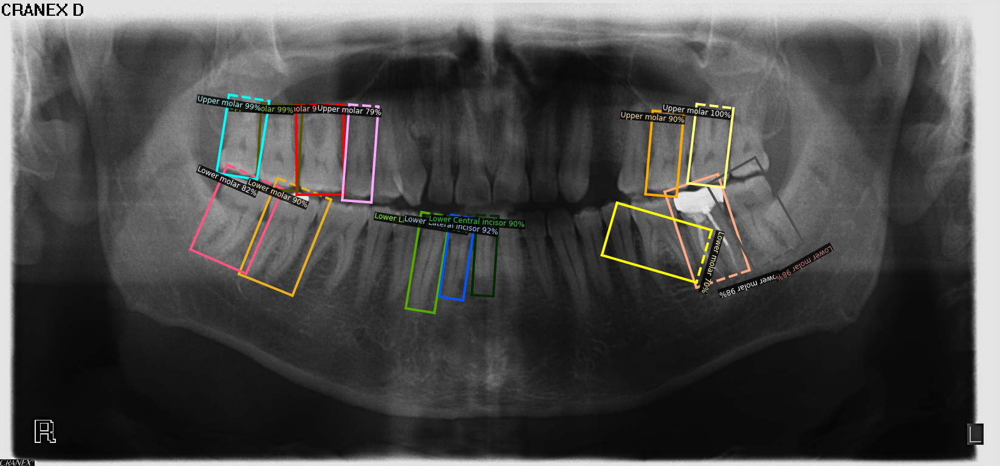

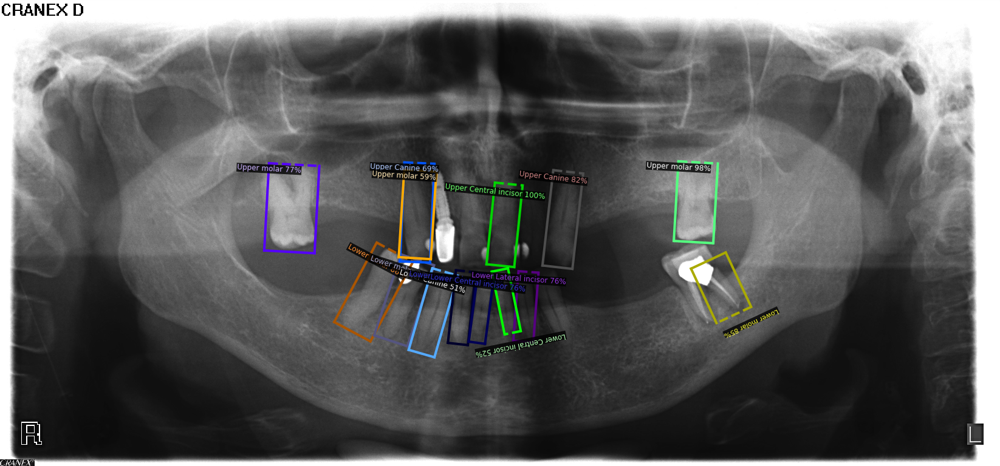

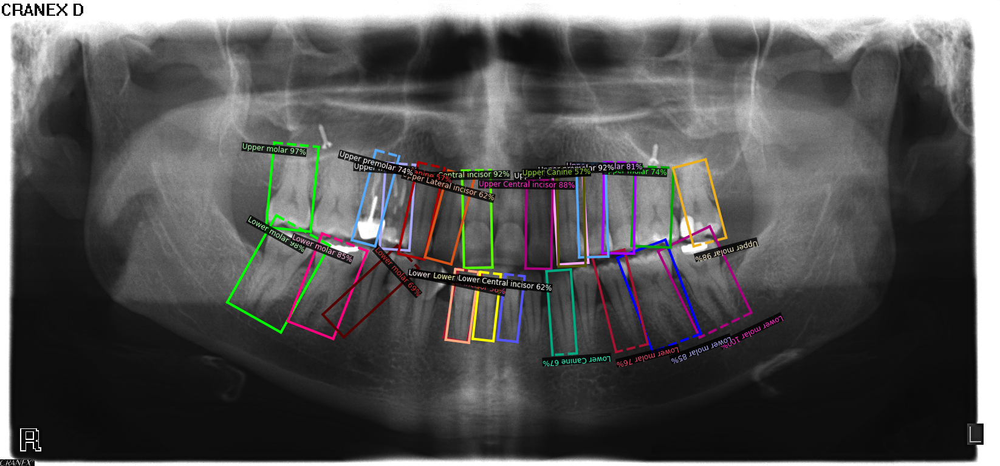

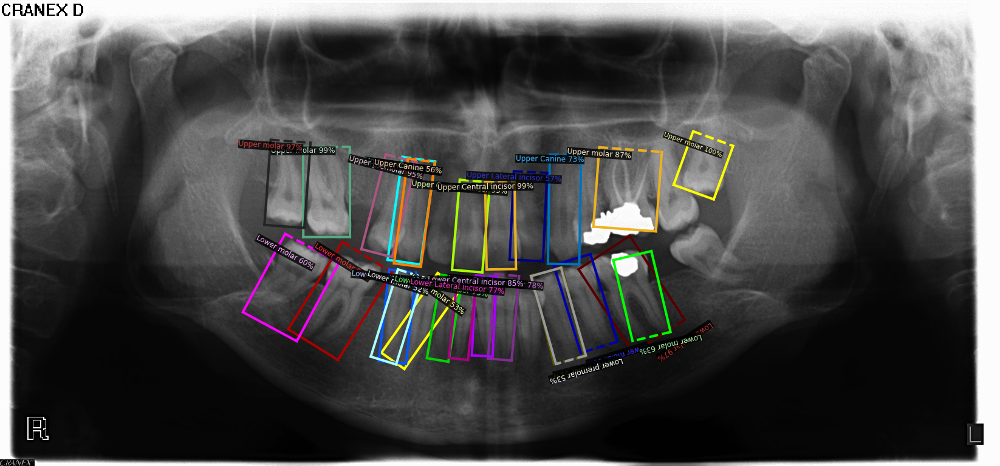

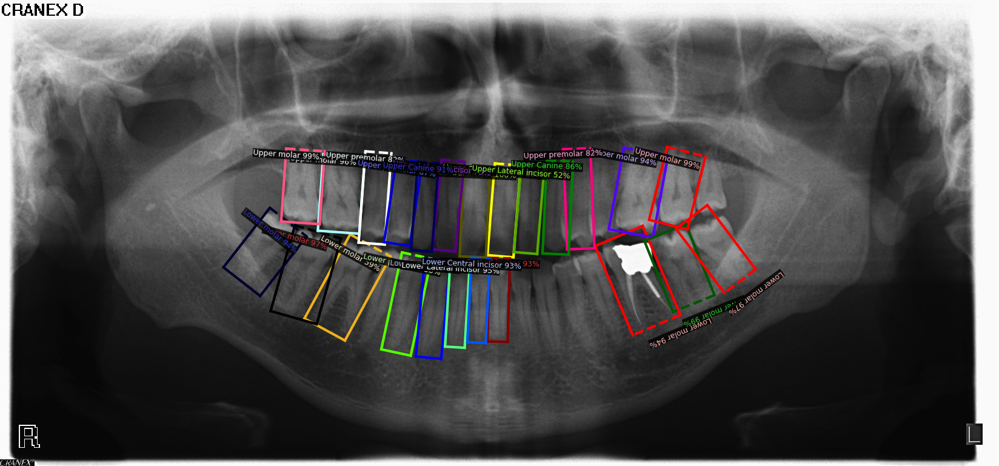

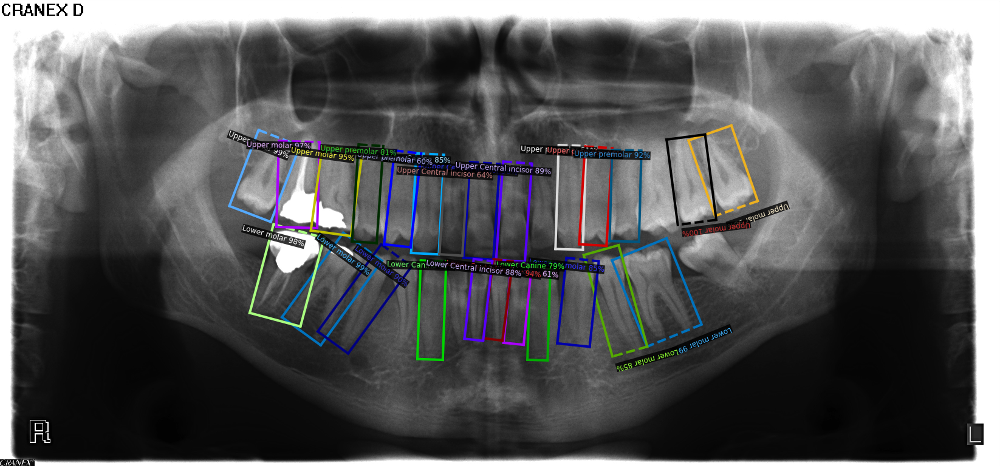

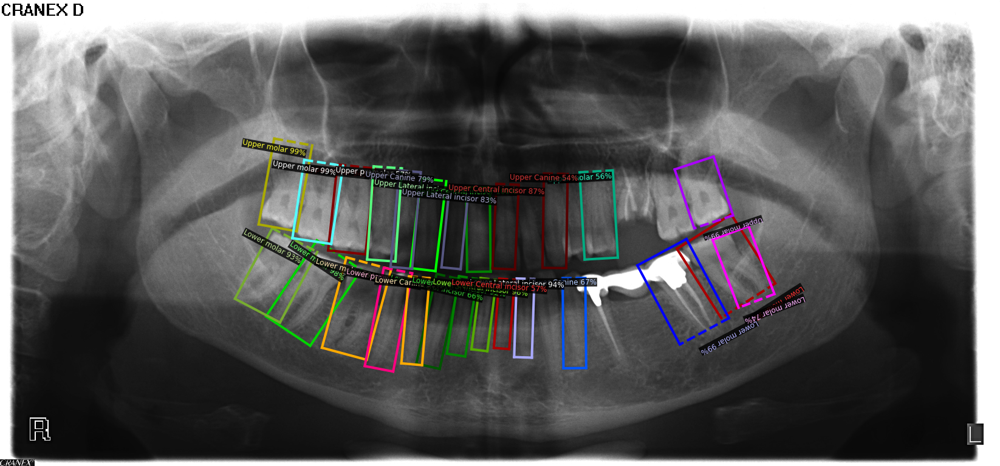

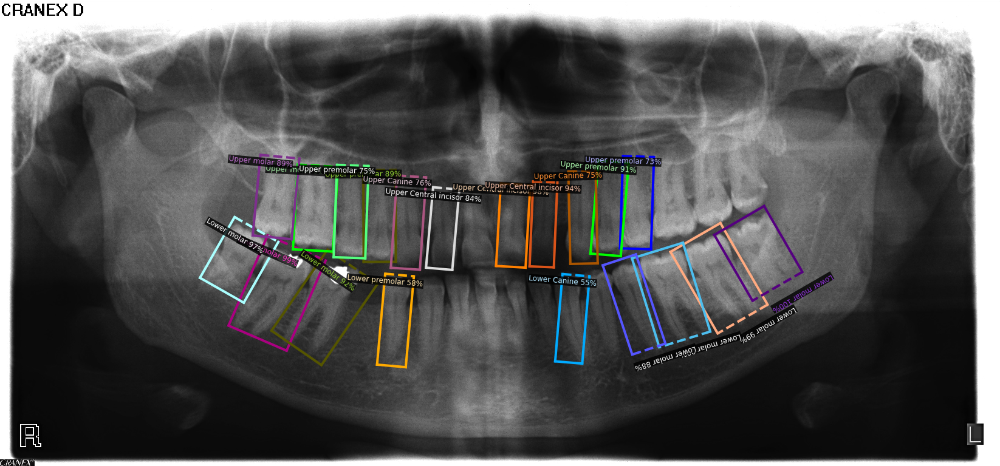

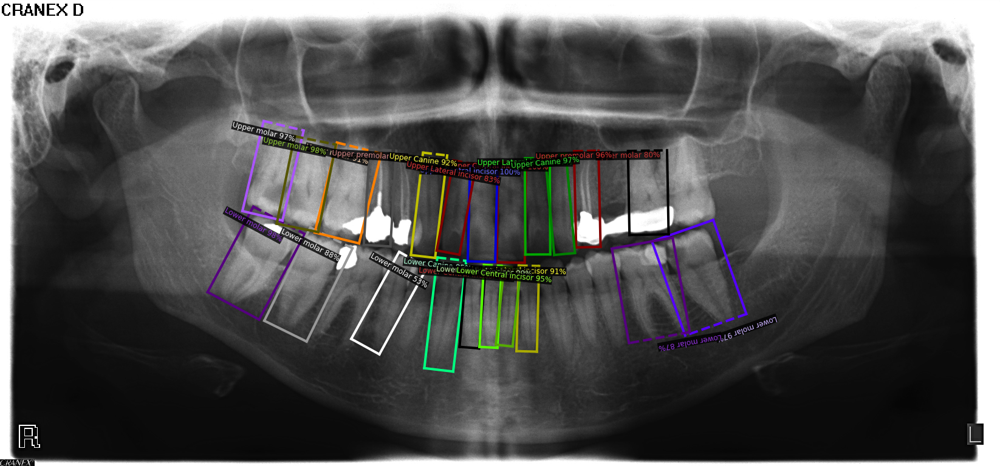

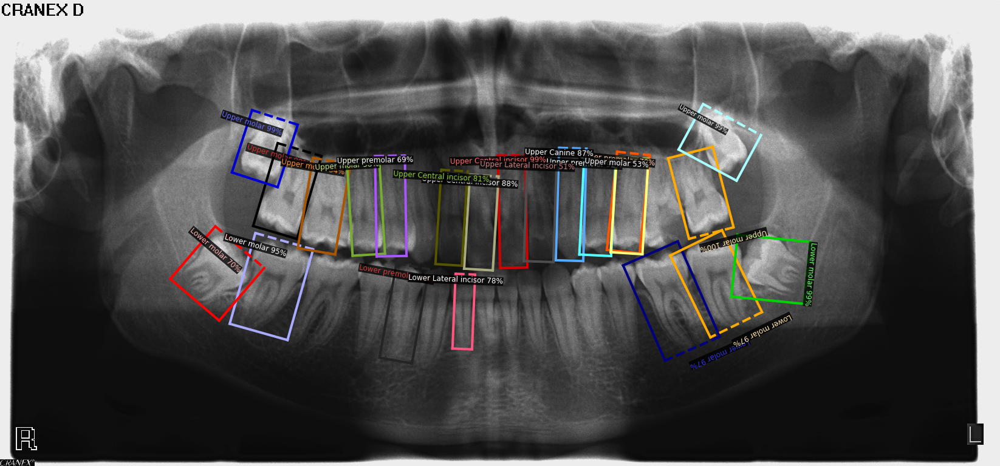

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_rotated_teeth_dicts("/content/drive/My Drive/rotated_dataset/rbtest.json")
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=rename_rotated_teeth_train, 
                   scale=0.5, 
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    # import pdb;pdb.set_trace()
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import RotatedCOCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = RotatedCOCOEvaluator("rotated_teeth_test", cfg, False, output_dir = "./output/")
val_loader = build_detection_test_loader(cfg, "rotated_teeth_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [12/30 14:00:50 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[12/30 14:00:50 d2.evaluation.coco_evaluation]: 'rotated_teeth_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
WARNING [12/30 14:00:50 d2.data.datasets.coco]: Using previously cached COCO format annotations at './output/rotated_teeth_test_coco_format.json'. You need to clear the cache file if your dataset has been modified.
[12/30 14:00:50 d2.data.build]: Distribution of instances among all 11 categories:
|   category    | #instances   |   category    | #instances   |   category    | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
|  Upper molar  | 51           | Upper premo.. | 30           | Upper Canine  | 20           |
| Upper Later.. | 19           | Upper Centr.. | 20           |  Lower molar  | 